In [3]:
import pretty_midi
import symusic
import mido
import numpy as np
import joblib
import glob
import matplotlib.pyplot as plt
import matplotlib.gridspec
import collections
import os
from pathlib import Path
from util.play_midi import play_midi
from statistics import mean, stdev, variance
import random
import miditok
import pandas as pd
from tqdm import tqdm 
from symusic import Score

from huggingface_hub import notebook_login
import ipywidgets

In [2]:
midi_files = list(Path("data/archive").glob("**/*.mid"))

print(len(midi_files))

295


In [4]:
s = Score(midi_files[-2])

s_quantized = s.resample(tpq=6, min_dur=1)

# 4D np array, [modes, tracks, pitch, time]
s_pianoroll = s_quantized.pianoroll(
    modes=["onset", "frame", "offset"], # List[str]
    pitch_range=[0, 128],   # the pitch range (half-open interval) of the piano roll, [0, 128) by default
    encode_velocity=True    # make the pianoroll binary or filled with velocity
)
s_pianoroll[0].shape

(2, 128, 1346)

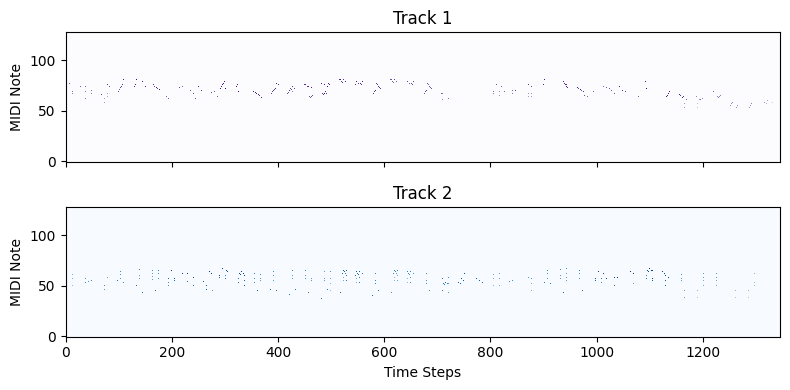

In [5]:
def plot_piano_roll(data, colors):
    fig, axs = plt.subplots(len(data), 1, figsize=(8, 4), sharex=True)

    for i in range(len(data)):
        # axs[i].imshow(data[i], aspect='auto', origin='lower', cmap=colors[i])
        axs[i].imshow(data[i], aspect='auto', origin='lower', cmap=colors[i], interpolation='nearest')
        axs[i].set_title(f'Track {i+1}')
        axs[i].set_ylabel('MIDI Note')

    axs[-1].set_xlabel('Time Steps')
    plt.tight_layout()
    plt.show()

# Define colors for each track
colors = ['Purples', 'Blues', 'Greens', 'Oranges', "Reds"]

# Plot the piano roll
plot_piano_roll(s_pianoroll[0], colors)

In [50]:
play_midi(midi_files[-5])

In [6]:
def extract_start_finish_end(midi_file_path):
    midi_data = pretty_midi.PrettyMIDI(midi_file_path)
    start_times = []
    end_times = []
    for instrument in midi_data.instruments:
        start_times.append(instrument.notes[0].start)
        end_times.append(instrument.notes[-1].start + instrument.notes[-1].duration)
    start_time = min(start_times)
    end_time = max(end_times)

    return start_time, end_time, midi_data.get_end_time()


start_time, end_time, song_length  = extract_start_finish_end(str(midi_files[-5]))
print(f"song length = {song_length}")
print(start_time)
print(end_time)

song length = 146.56503966250008
0.003379291666666667
134.56595468333342


In [43]:
def trim_midi_start(midi_file_path, output_file_path, start_time):
    midi_data = pretty_midi.PrettyMIDI(midi_file_path)
    
    trimmed_instruments = []
    
    for instrument in midi_data.instruments:
        trimmed_notes = []
        for note in instrument.notes:
            if note.start >= start_time:
                new_note = pretty_midi.Note(
                    velocity=note.velocity,
                    pitch=note.pitch,
                    start=note.start - start_time,  # Adjust start time relative to the new start
                    end=note.end - start_time  # Adjust end time relative to the new start
                )
                trimmed_notes.append(new_note)
        
        instrument.notes = trimmed_notes
        trimmed_instruments.append(instrument)
    
    trimmed_midi = pretty_midi.PrettyMIDI()
    trimmed_midi.instruments = trimmed_instruments
    
    # Save the trimmed MIDI file
    trimmed_midi.write(output_file_path)

def trim_midi_end(midi_file_path, output_file_path, end_time):

    midi_data = pretty_midi.PrettyMIDI(midi_file_path)
    
    trimmed_instruments = []
    
    for instrument in midi_data.instruments:
        trimmed_notes = []
        for note in instrument.notes:
            if note.start < end_time:
                new_note = pretty_midi.Note(
                    velocity=note.velocity,
                    pitch=note.pitch,
                    start=note.start,  # No need to adjust the start time
                    end=min(note.end, end_time)  # Adjust end time if it exceeds the end_time
                )
                trimmed_notes.append(new_note)
        
        instrument.notes = trimmed_notes
        trimmed_instruments.append(instrument)
    
    trimmed_midi = pretty_midi.PrettyMIDI()
    trimmed_midi.instruments = trimmed_instruments

    trimmed_midi.write(output_file_path)

song_lengths_pre = []
song_length_post = []
for song in midi_files:
    song = str(song)
    start, last, finish = extract_start_finish_end(song)
    song_lengths_pre.append(finish)
    output_file = "output.mid"
    if start >= 1:
        trim_midi_start(song, output_file, start)
        song = output_file
    if last-finish >= 1:
        trim_midi_end(song, output_file, finish-last)
    output_song = pretty_midi.PrettyMIDI(output_file)
    song_length_post.append(output_song.get_end_time())
    

Trimmed MIDI file saved to output.mid


In [18]:
play_midi("output.mid")

In [61]:
### Data augmentation

midi_aug_path = Path("to", "new", "location", "augmented")
ssong = miditok.data_augmentation.augment_dataset(
    # midi_files[:3],
    Path("data/archive"),
    pitch_offsets=[],
    velocity_offsets=[],
    duration_offsets=[10,25],
    out_path="output_"
)


Performing data augmentation:   0%|          | 0/295 [00:00<?, ?it/s]

Performing data augmentation: 100%|██████████| 295/295 [00:02<00:00, 105.52it/s]


In [66]:
play_midi("output_/albeniz/alb_esp1.mid")

In [64]:
play_midi("output_/albeniz/alb_esp1#d4800.mid")

In [65]:
play_midi("output_/albeniz/alb_esp1#d12000.mid")